In [ ]:
import tensorflow
from tensorflow import keras
print(tensorflow.__version__)

2.9.2


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install -U tensorflow-addons

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 39.3 MB/s eta 0:00:00


In [ ]:
import numpy as np
import tensorflow_addons as tfa
import matplotlib.pyplot as plt

In [ ]:
import pandas as pd
import seaborn as sns


In [ ]:
df=pd.read_csv('/content/drive/MyDrive/Colab_Notebooks/EEG_Brainwave_Emotion/emotions.csv')
print(df.head())

   # mean_0_a  mean_1_a  mean_2_a  mean_3_a  mean_4_a  mean_d_0_a  mean_d_1_a  \
0        4.62      30.3    -356.0      15.6      26.3       1.070       0.411   
1       28.80      33.1      32.0      25.8      22.8       6.550       1.680   
2        8.90      29.4    -416.0      16.7      23.7      79.900       3.360   
3       14.90      31.6    -143.0      19.8      24.3      -0.584      -0.284   
4       28.30      31.3      45.2      27.3      24.5      34.800      -5.790   

   mean_d_2_a  mean_d_3_a  mean_d_4_a  ...  fft_741_b  fft_742_b  fft_743_b  \
0      -15.70        2.06        3.15  ...       23.5       20.3       20.3   
1        2.88        3.83       -4.82  ...      -23.3      -21.8      -21.8   
2       90.20       89.90        2.03  ...      462.0     -233.0     -233.0   
3        8.82        2.30       -1.97  ...      299.0     -243.0     -243.0   
4        3.06       41.40        5.52  ...       12.0       38.1       38.1   

   fft_744_b  fft_745_b  fft_746_b  ff

# mean_0_a    0
mean_1_a      0
mean_2_a      0
mean_3_a      0
mean_4_a      0
             ..
fft_746_b     0
fft_747_b     0
fft_748_b     0
fft_749_b     0
label         0
Length: 2549, dtype: int64

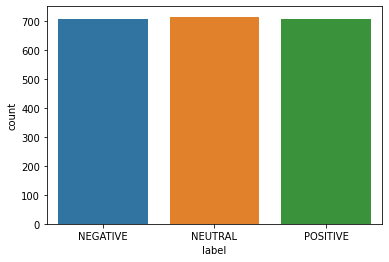

In [ ]:
sns.countplot(x='label',data=df)
df.isnull().sum()

In [ ]:
# Replace the string labels with numerical labels
encode=({'NEUTRAL':0,'POSITIVE':1,'NEGATIVE':2})
df_encoded=df.replace(encode)
print(df_encoded['label'].value_counts())

0    716
2    708
1    708
Name: label, dtype: int64


In [ ]:
# Split the data into features and labels
X = df_encoded.drop(["label"],axis=1)
y = df_encoded.loc[:,'label'].values

<ipython-input-13-77471adda296>:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(5,5))


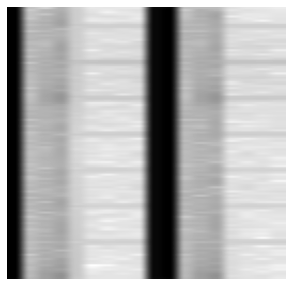

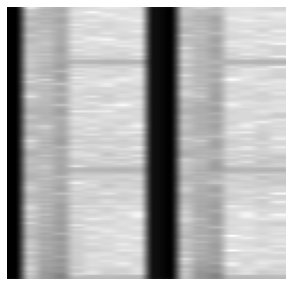

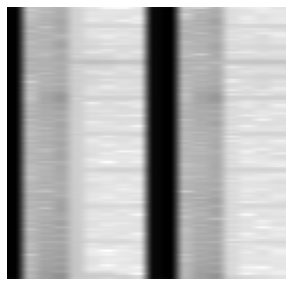

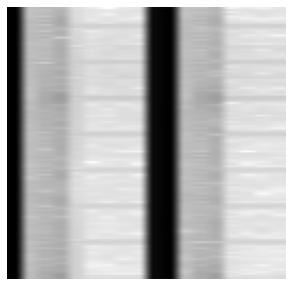

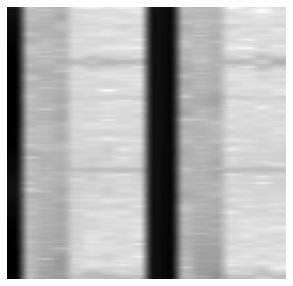

...

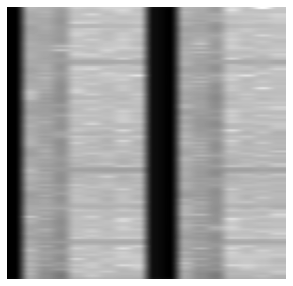

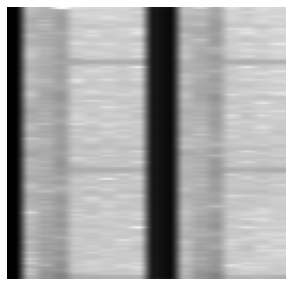

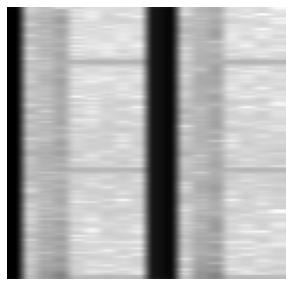

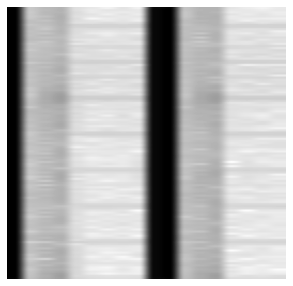

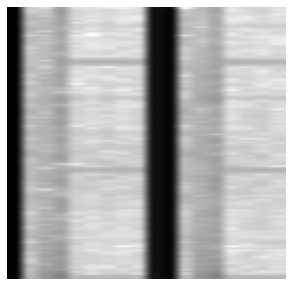

In [ ]:
import os
import matplotlib.pyplot as plt
import cv2

# Calculate the spectrogram for each time-series in the dataset
images = []
for i in range(X.shape[0]):
    data = X.iloc[i].values
    fig = plt.figure(figsize=(5,5))
    plt.specgram(data, NFFT=256, Fs=2, Fc=0, noverlap=128, cmap='gray_r', sides='default', mode='default', scale='dB');
    plt.axis('off');
    fig.canvas.draw()
    image = np.array(fig.canvas.renderer._renderer)
    images.append(image)

# Save the spectrogram images to the respective folders
image_folder = '/content/drive/MyDrive/Colab_Notebooks/EEG_Brainwave_Emotion/images/'
if not os.path.exists(image_folder):
    os.makedirs(image_folder)

for i, label in enumerate(y):
    class_folder = os.path.join(image_folder, str(label))
    if not os.path.exists(class_folder):
        os.makedirs(class_folder)
    img_path = os.path.join(class_folder, 'img_' + str(i) + '.jpg')
    cv2.imwrite(img_path, images[i])
